### Notebook for the generation of an annotated manifold with `scANVI` 

- **Developed by:** Carlos Talavera-López Ph.D
- **Institute of Systems Immunology (WüSI) - JMU-Würzburg**
- v230608

### Import required modules

In [1]:
import anndata
import warnings
import numpy as np
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
from SCCAF import SCCAF_assessment, plot_roc
from scib_metrics.benchmark import Benchmarker

### Set up working environment

In [15]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma_r', dpi_save = 300, vector_friendly = True, format = 'svg')

-----
anndata     0.8.0
scanpy      1.9.3
-----
PIL                 9.4.0
SCCAF               NA
absl                NA
appnope             0.1.3
asttokens           NA
attr                23.1.0
backcall            0.2.0
beta_ufunc          NA
binom_ufunc         NA
cffi                1.15.1
chex                0.1.6
colorama            0.4.6
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.6
decorator           5.1.1
executing           1.2.0
h5py                3.8.0
hypergeom_ufunc     NA
igraph              0.10.4
importlib_resources NA
invgauss_ufunc      NA
ipykernel           6.15.0
ipywidgets          8.0.6
jax                 0.4.13
jaxlib              0.4.13
jedi                0.18.2
joblib              1.2.0
kiwisolver          1.4.4
leidenalg           0.9.1
llvmlite            0.39.1
louvain             0.8.0
matplotlib          3.7.1
matplotlib_inline   0.1.6
ml_dtypes           0.2.0
mpl_toolkits        NA
natsort    

### Read in Healthy data

In [5]:
epith_club = sc.read_h5ad('../../../data/Epithelial_Club_ctl230718_scANVI_annotated.raw.h5ad')
epith_club

AnnData object with n_obs × n_vars = 15435 × 27208
    obs: 'sex', 'age', 'ethnicity', 'PaCO2', 'donor', 'infection', 'disease', 'SMK', 'illumina_stimunr', 'bd_rhapsody', 'n_genes', 'doublet_scores', 'predicted_doublets', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', 'condition', 'sample_group', '_scvi_batch', '_scvi_labels', 'IAV_score', 'group', 'C_scANVI', 'cell_type', 'leiden', 'leiden_states', 'seed_labels', 'Viral_score', 'C_scANVI_v2'
    var: 'mt', 'ribo', 'n_cells_by_counts-V1', 'mean_counts-V1', 'pct_dropout_by_counts-V1', 'total_counts-V1', 'n_cells_by_counts-V2', 'mean_counts-V2', 'pct_dropout_by_counts-V2', 'total_counts-V2', 'n_cells_by_counts-V3', 'mean_counts-V3', 'pct_dropout_by_counts-V3', 'total_counts-V3', 'n_cells_by_counts-V4', 'mean_counts-V4', 'pct_dropout_by_counts-V4', 'total_counts-V4', 'n_cells_by_count

In [6]:
epith_club.obs['C_scANVI_v2'].cat.categories

Index(['Club_1', 'Club_9', 'Club_18'], dtype='object')

In [8]:
epith_club.obs['donor'].cat.categories

Index(['CHE-01', 'CHE-02', 'CHE-03', 'CSE-03', 'CSE-06', 'CSE-07', 'GER-02',
       'GER-12', 'GER-14', 'GNR-06', 'GNR-07', 'GNR-08'],
      dtype='object')

- Visualise corrected dataset

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:16)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


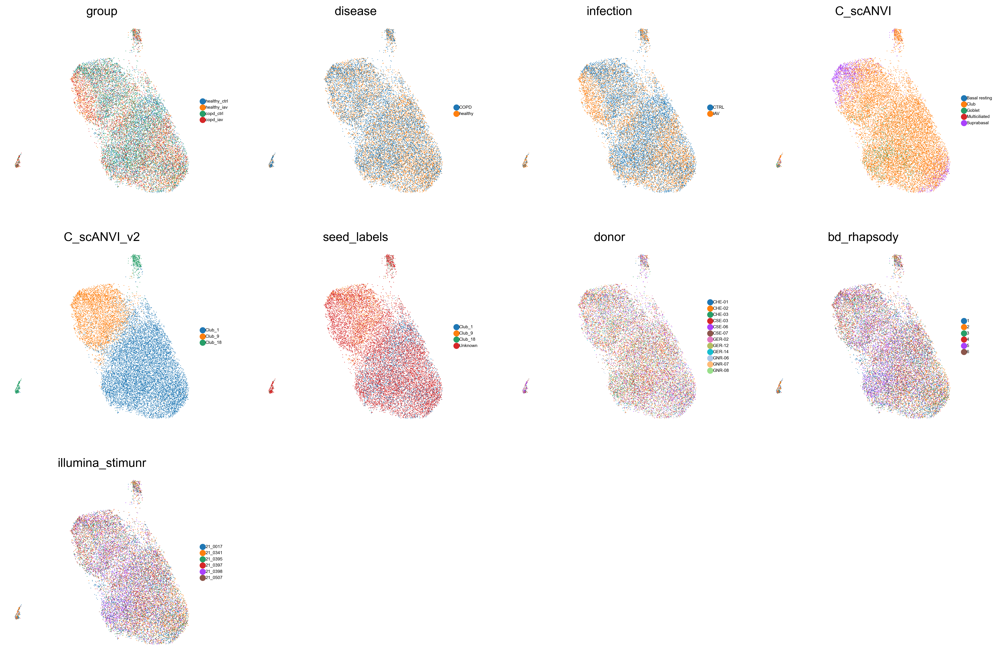

In [9]:
sc.pp.neighbors(epith_club, use_rep = "X_scANVI", n_neighbors = 50, metric = 'minkowski')
sc.tl.umap(epith_club, min_dist = 0.3, spread = 3, random_state = 1712)
sc.pl.umap(epith_club, frameon = False, color = ['group', 'disease', 'infection', 'C_scANVI', 'C_scANVI_v2', 'seed_labels', 'donor', 'bd_rhapsody', 'illumina_stimunr'], size = 2, legend_fontsize = 5, ncols = 4)

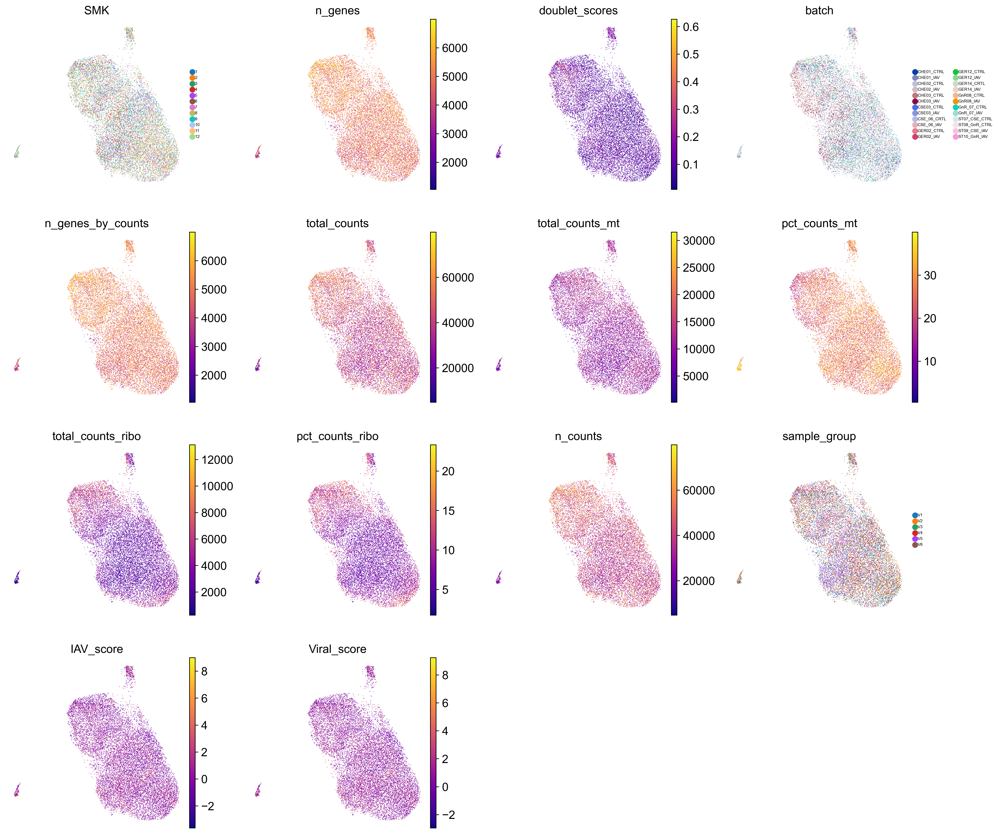

In [10]:
sc.pl.umap(epith_club, frameon = False, color = ['SMK', 'n_genes', 'doublet_scores', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'n_counts', 'sample_group', 'IAV_score', 'Viral_score'], size = 2, legend_fontsize = 5, ncols = 4, cmap = 'plasma')

### Clustering manifold for Mixed cell states identification

running Leiden clustering
    finished: found 7 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:11)


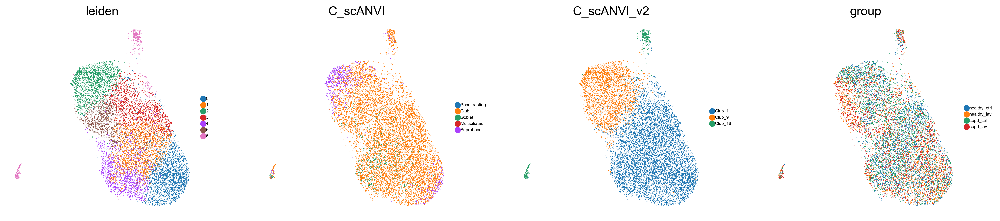

In [16]:
sc.tl.leiden(epith_club, resolution = 0.7, random_state = 1712)
sc.pl.umap(epith_club, frameon = False, color = ['leiden', 'C_scANVI', 'C_scANVI_v2', 'group'], size = 2, legend_fontsize = 5, ncols = 4)

Mean CV accuracy: 0.7338
Accuracy on the training set: 1.0000
Accuracy on the hold-out set: 0.7068


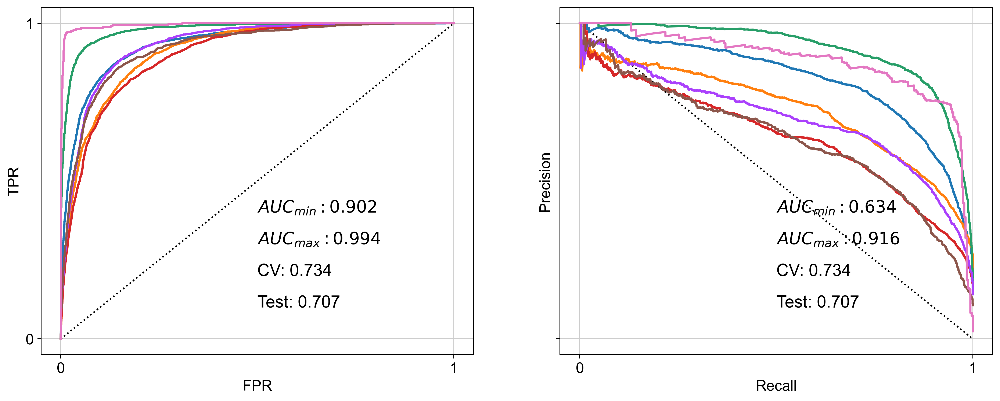

In [14]:
y_prob, y_pred, y_test, clf, cvsm, acc = SCCAF_assessment(epith_club.X, epith_club.obs['leiden'], n = 300)
plot_roc(y_prob, y_test, clf, cvsm = cvsm, acc = acc)
plt.rcParams["figure.figsize"] = (16,6)
plt.show()

### Annotate clusters based on marker genes WRST

In [17]:
epith_club_log = epith_club.copy()
epith_club_log

AnnData object with n_obs × n_vars = 15435 × 27208
    obs: 'sex', 'age', 'ethnicity', 'PaCO2', 'donor', 'infection', 'disease', 'SMK', 'illumina_stimunr', 'bd_rhapsody', 'n_genes', 'doublet_scores', 'predicted_doublets', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts', 'percent_chrY', 'XIST-counts', 'S_score', 'G2M_score', 'condition', 'sample_group', '_scvi_batch', '_scvi_labels', 'IAV_score', 'group', 'C_scANVI', 'cell_type', 'leiden', 'leiden_states', 'seed_labels', 'Viral_score', 'C_scANVI_v2'
    var: 'mt', 'ribo', 'n_cells_by_counts-V1', 'mean_counts-V1', 'pct_dropout_by_counts-V1', 'total_counts-V1', 'n_cells_by_counts-V2', 'mean_counts-V2', 'pct_dropout_by_counts-V2', 'total_counts-V2', 'n_cells_by_counts-V3', 'mean_counts-V3', 'pct_dropout_by_counts-V3', 'total_counts-V3', 'n_cells_by_counts-V4', 'mean_counts-V4', 'pct_dropout_by_counts-V4', 'total_counts-V4', 'n_cells_by_count

In [18]:
sc.pp.normalize_total(epith_club_log, target_sum = 1e6, exclude_highly_expressed = True)
sc.pp.log1p(epith_club_log)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['BPIFA1', 'MT-CO1', 'MT-CO2', 'MT-CO3', 'MT-CYB', 'MT-ND1', 'MT-ND2', 'MT-ND3', 'MT-ND4', 'MT-ND5', 'NC_026431.1', 'NC_026432.1', 'NC_026433.1', 'NC_026436.1', 'SCGB1A1', 'SCGB3A1']
    finished (0:00:00)


In [19]:
sc.tl.rank_genes_groups(epith_club_log, 'leiden', method = 'wilcoxon', n_genes = 100, use_raw = False)
result = epith_club_log.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_markers = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','logfoldchanges', 'pvals_adj']})
wilcox_markers.head(10)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:59)


,0_n,0_l,0_p,1_n,1_l,1_p,2_n,2_l,2_p,3_n,...,3_p,4_n,4_l,4_p,5_n,5_l,5_p,6_n,6_l,6_p
0,KRT4,4.316040,0.000000e+00,WFDC2,1.344800,0.0,S100A2,3.272209,0.0,CTSB,...,2.960163e-289,WFDC2,1.643094,0.000000e+00,IGFBP3,1.877770,0.000000e+00,KIT,11.937251,8.884618e-265
1,CSTA,2.423019,0.000000e+00,PIGR,3.157775,0.0,IGFBP7,4.819650,0.0,SAT1,...,1.614513e-256,SLPI,1.275731,0.000000e+00,RARRES1,3.341496,2.298763e-242,ANXA4,2.417785,1.548382e-229
2,ALDH1A1,1.600692,0.000000e+00,BPIFB1,2.850918,0.0,S100A10,3.014838,0.0,PSAP,...,3.285788e-171,BPIFB1,3.443180,0.000000e+00,SAA1,2.839300,1.719132e-212,SLC6A9,5.335683,2.377198e-197
3,ALOX15,2.784297,0.000000e+00,XBP1,1.612174,0.0,ANXA2,0.834023,0.0,MDK,...,1.889158e-148,SCGB3A1,3.059263,0.000000e+00,CXCL8,3.099473,2.921830e-209,NREP,7.225909,3.918891e-180
4,GABRP,2.400001,0.000000e+00,CD74,1.435307,0.0,KRT5,3.340215,0.0,TNFSF10,...,3.054396e-127,CD74,1.589284,0.000000e+00,ITGB6,2.698934,1.967815e-200,AZGP1,9.029062,3.775782e-179
5,GLUL,0.630572,0.000000e+00,SCGB3A1,2.347864,0.0,S100A11,0.707595,0.0,VTCN1,...,1.494799e-121,PIGR,3.200516,0.000000e+00,KRT17,2.628667,2.803953e-197,CRYM,6.608717,4.376088e-174
6,DBI,0.888972,5.321339e-294,C3,1.738369,0.0,CLDN1,3.450396,0.0,HIST1H2AC,...,3.016245e-112,B2M,0.670541,0.000000e+00,SAA2,3.143251,5.211931e-188,PHLDA1,4.561231,3.795533e-168
7,KRT19,0.325454,1.137012e-285,GOLM1,1.457530,0.0,SERPINB5,3.381501,0.0,FTL,...,4.700636e-105,XBP1,1.640088,0.000000e+00,TGM2,2.791093,1.793301e-186,PTMA,0.726028,9.152040e-165
8,TP53I3,2.126144,2.500206e-281,SCNN1A,0.936852,0.0,RPL32,0.817621,0.0,FTH1,...,2.754456e-100,CXCL17,0.668270,3.774160e-280,CTSB,0.608832,7.492329e-184,HEPACAM2,10.543626,1.584526e-164
9,SCGB1A1,2.795638,9.900817e-279,ALCAM,0.776744,0.0,RPL37A,0.750605,0.0,CRABP2,...,8.916003e-93,AGR2,1.019138,5.580442e-268,CDH3,1.261291,1.519825e-170,HSP90AA1,0.645211,1.478319e-132


In [20]:
wilcox_markers.to_csv('Epithelial_Club_ctl230718_mixed_states_WilcoxRST_markers.csv', sep = ',', index = False)

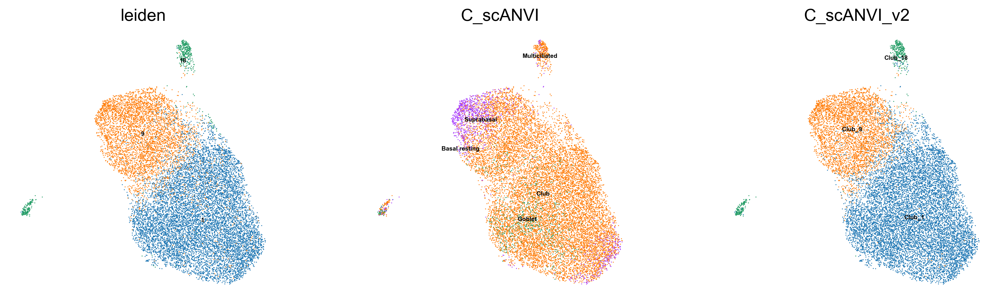

In [21]:
sc.pl.umap(epith_mixed, frameon = False, color = ['leiden', 'C_scANVI', 'C_scANVI_v2'], size = 2.5, legend_fontsize = 5, ncols = 3, legend_loc = 'on data')

In [22]:
epith_club_log.write('../../../data/Epithelial_Club_ctl230718_scANVI_annotated.log.h5ad')

In [23]:
epith_club.obs['leiden'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6'], dtype='object')

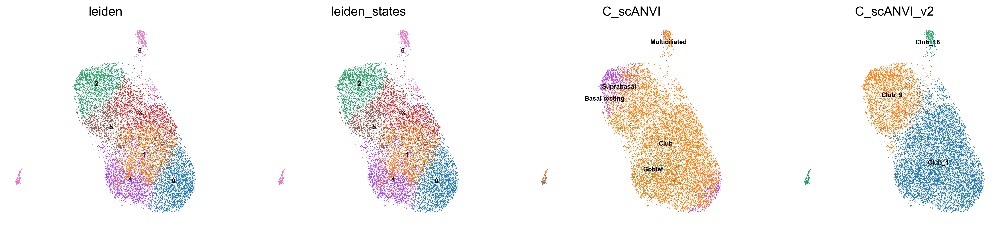

In [24]:
epith_club.obs['leiden_states'] = epith_club.obs['leiden']
epith_club.obs['leiden_states'].cat.categories = ['0', '1', '2', '3', '4', '5', '6']
sc.pl.umap(epith_club, frameon = False, color = ['leiden', 'leiden_states', 'C_scANVI', 'C_scANVI_v2'], size = 2.5, legend_fontsize = 7, ncols = 4, legend_loc = 'on data')

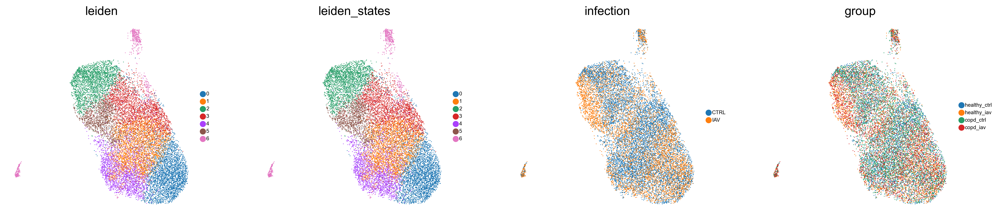

In [26]:
sc.pl.umap(epith_club, frameon = False, color = ['leiden', 'leiden_states', 'infection', 'group'], size = 3, legend_fontsize = 6, ncols = 4)

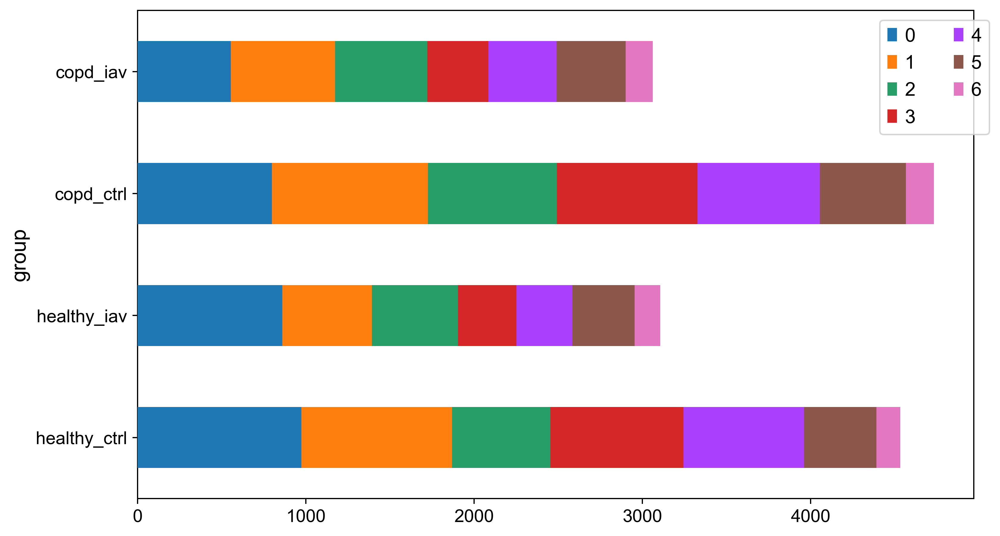

In [27]:
ax1 = pd.crosstab(epith_club.obs['group'], epith_club.obs['leiden_states']).plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (10,6), fontsize = 12, grid = False)
horiz_offset = 1.03
vert_offset = 1.0
ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset), ncol = 2)

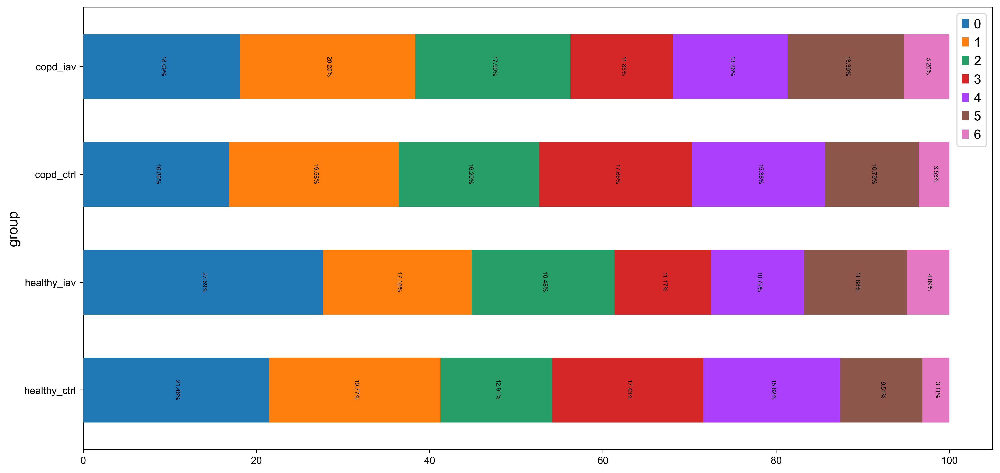

In [29]:
data = pd.crosstab(epith_club.obs['group'], epith_club.obs['leiden_states'])
totals = data.sum(axis = 1)
percent = data.div(totals, axis = 0).mul(100).round(2)

ax1 = percent.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (16,8), fontsize = 10, grid = False, width = 0.6)
horiz_offset = 1.0
vert_offset = 1.0
ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset), ncol = 1)

for c in ax1.containers:
    
    # custom label calculates percent and add an empty string so 0 value bars don't have a number
    labels = [f'{w:0.2f}%' if (w := v.get_width()) > 0 else '' for v in c]
    
    # add annotations
    ax1.bar_label(c, labels = labels, label_type = 'center', padding = 1, color = 'black', rotation = 270, fontsize = 6)

### Export annotated sample object 

In [30]:
epith_club.obs.index = pd.Index(['-'.join(idx.split('-')[:3]) for idx in epith_club.obs.index])
epith_club.obs.index

Index(['558312-ST07_CSE_CTRL-V1', '324912-ST07_CSE_CTRL-V1',
       '525685-ST07_CSE_CTRL-V1', '820008-ST07_CSE_CTRL-V1',
       '636908-ST07_CSE_CTRL-V1', '853144-ST07_CSE_CTRL-V1',
       '609300-ST07_CSE_CTRL-V1', '40281-ST07_CSE_CTRL-V1',
       '615861-ST07_CSE_CTRL-V1', '691353-ST07_CSE_CTRL-V1',
       ...
       '6210438-CSE03_IAV-V6', '6080300-CSE03_IAV-V6', '5029279-CSE03_IAV-V6',
       '10767772-CSE03_IAV-V6', '7107164-CSE03_IAV-V6',
       '12241997-CSE03_IAV-V6', '10209461-CSE03_IAV-V6',
       '1359014-CSE03_IAV-V6', '6501913-CSE03_IAV-V6',
       '11507769-CSE03_IAV-V6'],
      dtype='object', length=15435)

In [31]:
epith_club.obs['C_scANVI_v2'].cat.categories

Index(['Club_1', 'Club_9', 'Club_18'], dtype='object')

In [32]:
epith_club.obs['leiden_states'].value_counts()

0    3185
1    2976
2    2412
3    2336
4    2184
5    1721
6     621
Name: leiden_states, dtype: int64

### Export annotated object with raw counts

In [33]:
epith_club.write('../../../data/Epithelial_Club_ctl230608_states.raw.h5ad')